In [269]:
%matplotlib inline

In [270]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [271]:
df_raw = pd.read_csv('../output_chirp.csv')
df_raw.rename(columns={'# X_frame0': 'X_frame0'}, inplace=True)

df2 = df_raw.T
df2['time'] = [int(x.split('frame')[1]) for x in df_raw.columns]
df2['coord'] = [x.split('_')[0] for x in df2.index]
df2.index = np.arange(len(df2))

df = df2.pivot_table(columns=['time', 'coord'])
df.index = ['star{}'.format(x) for x in df.index]

In [272]:
df

time          0                             1                             2    \
coord           X         Y         Z         X         Y         Z         X   
star0   -0.192250 -0.436256 -0.879045 -0.189992 -0.441171 -0.877081 -0.186895   
star1   -0.389621 -0.494780 -0.776781 -0.385151 -0.500515 -0.775334 -0.379007   
star2   -0.125649 -0.854802  0.503514 -0.122563 -0.850439  0.511598 -0.118324   
star3   -0.505427  0.861080  0.055547 -0.497098  0.865463  0.062181 -0.485599   
star4    0.814116  0.196144  0.546573  0.817341  0.202341  0.539455  0.821618   
...           ...       ...       ...       ...       ...       ...       ...   
star495 -0.623135  0.740444  0.251883 -0.614427  0.746586  0.255124 -0.602392   
star496 -0.849285  0.076140  0.522415 -0.854228  0.078732  0.513902 -0.860844   
star497 -0.600250 -0.447459 -0.662933 -0.594254 -0.453489 -0.664236 -0.585987   
star498 -0.896637  0.331349  0.293684 -0.895890  0.339724  0.286302 -0.894686   
star499 -0.259348  0.642583 -0.720989 -0.255987  0.648795 -0.716614 -0.251365   

time                              3    ...       996       997            \
coord           Y         Z         X  ...         Z         X         Y   
star0   -0.447864 -0.874350 -0.183208  ... -0.890286 -0.122777 -0.575419   
star1   -0.508309 -0.773289 -0.371668  ... -0.784597 -0.249242 -0.651802   
star2   -0.844344  0.522573 -0.113267  ...  0.453873 -0.031021 -0.694551   
star3    0.871274  0.071242 -0.471793  ...  0.015560 -0.238341  0.940209   
star4    0.210782  0.529636  0.826496  ...  0.588240  0.874027  0.367868   
...           ...       ...       ...  ...       ...       ...       ...   
star495  0.754838  0.259506 -0.587926  ...  0.231756 -0.340210  0.879631   
star496  0.082262  0.502176 -0.868479  ...  0.572466 -0.956033  0.147986   
star497 -0.461677 -0.665938 -0.576072  ... -0.654044 -0.406389 -0.609791   
star498  0.351110  0.276149 -0.892986  ...  0.337247 -0.828841  0.555600   
star499  0.657214 -0.710553 -0.245838  ... -0.746299 -0.153470  0.805747   

time                    998                           999                      
coord           Z         X         Y         Z         X         Y         Z  
star0   -0.808591 -0.242253 -0.319637 -0.916049 -0.100556 -0.615086 -0.782021  
star1   -0.716263 -0.485387 -0.357077 -0.798057 -0.203923 -0.693593 -0.690901  
star2    0.718774 -0.191635 -0.931227  0.309987 -0.002168 -0.635605  0.772011  
star3    0.243313 -0.671925  0.734784 -0.092790 -0.154716  0.943408  0.293332  
star4    0.317412  0.720695  0.052534  0.691259  0.877477  0.413114  0.243661  
...           ...       ...       ...       ...       ...       ...       ...  
star495  0.332424 -0.795856  0.580544  0.171994 -0.249816  0.903014  0.349511  
star496  0.253181 -0.715841  0.016247  0.698074 -0.971469  0.166878  0.168524  
star497 -0.680443 -0.723597 -0.302555 -0.620378 -0.342550 -0.651248 -0.677152  
star498  0.065815 -0.884004  0.135210  0.447498 -0.792009  0.610504 -0.002769  
star499 -0.572030 -0.330492  0.490249 -0.806493 -0.119507  0.845746 -0.520031  

[500 rows x 3000 columns]

## Astrometric displacement

Let's define the astrometric effect of a GW on a set of stars; this will be given by the displacement `dN`. We will also construct GW polarization basis tensors to construct arbitrary GWs.

In [273]:
background_stars = df[0].values
new_stars = df[1].values

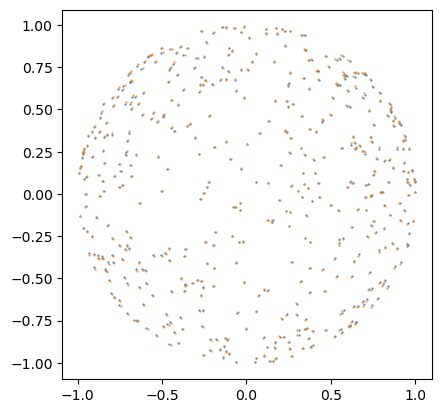

In [274]:
fig, ax = plt.subplots()
ax.scatter(background_stars[:, 0], background_stars[:, 1], marker='.', s=1)
ax.scatter(new_stars[:, 0], new_stars[:, 1], marker='.', s=1, c='C1')
ax.set_aspect('equal')

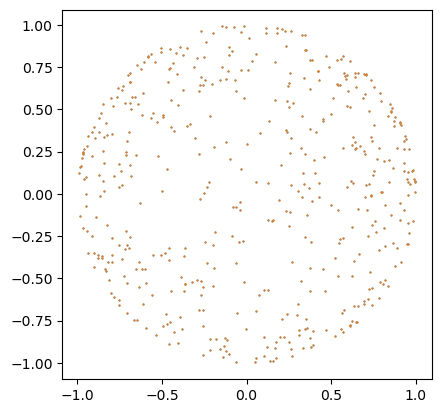

In [275]:
# animate the above plot to make a GIF
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# plot background stars
fig, ax = plt.subplots()
ax.scatter(background_stars[:, 0], background_stars[:, 1], marker='.', s=1)
sc = ax.scatter([], [], marker='.', s=1)
# set equal aspect ratio for ax
ax.set_aspect('equal')

times = df.columns.get_level_values(0).unique()

def animate(i):
    sc.set_offsets(df[i].values[...,:2])
    return sc,

ani = FuncAnimation(fig, animate, frames=times, blit=True);

In [276]:
HTML(ani.to_jshtml())

Animation size has reached 20996936 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [251]:
chirp_mass = 30
duration = 0.5  # seconds
nsamp = 1000

c = 299792458  # speed of light
G = 6.67430e-11  # Newton's constant
msun = 1.989e30  # solar mass
chirp_mass *= msun
chirp_radius = G * chirp_mass / c**2

tau = np.linspace(duration, 0, nsamp, endpoint=False)
f = 2*(5/256/tau)**(3/8) / (chirp_radius/c)**(5/8)
phis = 2*np.pi*f*tau

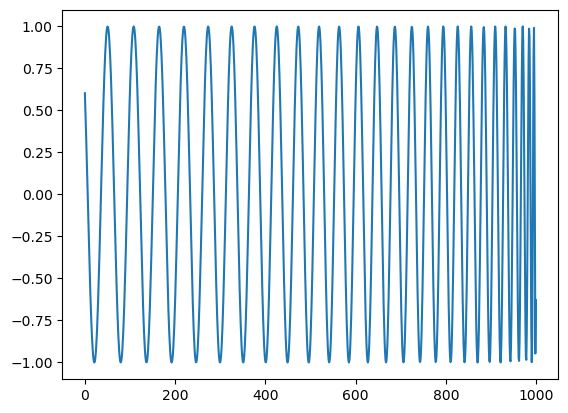

In [252]:
plt.plot(np.cos(phis))

In [219]:
dist_mpc = 400
distance = dist_mpc * 3.08567758149137e22  # Mpc to meters
amp = chirp_radius * (5*chirp_radius/c/tau)**(1/4) / distance
amp *= 5e19 

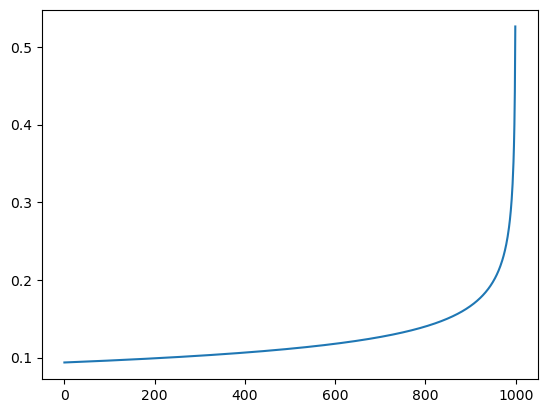

In [220]:
plt.plot(amp)